# Анализ


In [3]:
import pandas as pd
import warnings
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split
warnings.filterwarnings("ignore")
import seaborn as sns
import plotly.express as px
import plotly.graph_objs as go
import kaleido
from sklearn.preprocessing import MinMaxScaler, MaxAbsScaler

import matplotlib.pyplot as plt
import pm4py
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import statsmodels.api as sm
import warnings
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.pipeline import make_pipeline
from sklearn.tree import DecisionTreeRegressor
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.probability import FreqDist
from nltk.stem import WordNetLemmatizer
import nltk
from wordcloud import WordCloud
import plotly.io as pio
import plotly.offline as pyo
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import statsmodels.api as sm
import warnings
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.pipeline import make_pipeline
from sklearn.tree import DecisionTreeRegressor
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from statsmodels.stats.outliers_influence import variance_inflation_factor as vif
from sklearn.metrics import roc_curve, auc
from linearmodels import PanelOLS, BetweenOLS, FamaMacBeth, FirstDifferenceOLS
from linearmodels.panel import compare
from linearmodels.panel import RandomEffects
from statsmodels.stats.outliers_influence import variance_inflation_factor

warnings.filterwarnings("ignore")

pd.set_option("display.max_columns", None)
pd.set_option("display.max_rows", None)
pd.set_option('display.max_colwidth', None)

In [4]:
def poly_build(df, degree, y_name, color, legend):
    X = df[['t']].values
    y = df[y_name].values
    poly = PolynomialFeatures(degree)
    X_poly = poly.fit_transform(X)
    X_train_poly, X_test_poly, y_train, y_test = train_test_split(X_poly, y, test_size=0.2, random_state=42)

    poly_model = sm.OLS(y_train, X_train_poly).fit()
    y_pred_poly = poly_model.predict(X_test_poly)
    print("Polynomial Regression R-squared:", r2_score(y_test, y_pred_poly))
    print("Polynomial Regression RMSE:", np.sqrt(mean_squared_error(y_test, y_pred_poly)))

    t_range = np.linspace(X.min(), X.max()).reshape(-1, 1)
    t_range_poly = poly.transform(t_range)
    y_pred = poly_model.predict(t_range_poly)
    plt.plot(t_range, y_pred,  linewidth=2, color=color, label="Полиномиальная регрессия {} (степень {})".format(legend, degree))

# Repo preparation

In [5]:
paths = [
"/Users/valentina/Desktop/datasets/Dreamacro/clash/1714024639",
"/Users/valentina/Desktop/datasets/FiloSottile/mkcert/1713725714",
"/Users/valentina/Desktop/datasets/alist-org/alist/1714400580",
"/Users/valentina/Desktop/datasets/antonmedv/fx/1714495475",
"/Users/valentina/Desktop/datasets/aquasecurity/trivy/1717128023",
"/Users/valentina/Desktop/datasets/astaxie/build-web-application-with-golang/1713550000",
"/Users/valentina/Desktop/datasets/avelino/awesome-go/1713151727",
"/Users/valentina/Desktop/datasets/beego/beego/1714708320",
"/Users/valentina/Desktop/datasets/buger/goreplay/1715446242",
"/Users/valentina/Desktop/datasets/caddyserver/caddy/1713431218",
"/Users/valentina/Desktop/datasets/charmbracelet/bubbletea/1714410136",
"/Users/valentina/Desktop/datasets/cli/cli/1714589198",
"/Users/valentina/Desktop/datasets/cloudreve/Cloudreve/1715420989",
"/Users/valentina/Desktop/datasets/cockroachdb/cockroach/1716646857",
"/Users/valentina/Desktop/datasets/containers/podman/1715495638",
"/Users/valentina/Desktop/datasets/coreybutler/nvm-windows/1715103740",
"/Users/valentina/Desktop/datasets/dapr/dapr/1715001823",
"/Users/valentina/Desktop/datasets/derailed/k9s/1715175793",
"/Users/valentina/Desktop/datasets/docker/compose/1714741373",
"/Users/valentina/Desktop/datasets/ehang-io/nps/1715483904",
"/Users/valentina/Desktop/datasets/etcd-io/etcd/1717477424",
"/Users/valentina/Desktop/datasets/ethereum/go-ethereum/1713632067",
"/Users/valentina/Desktop/datasets/evanw/esbuild/1714102421",
"/Users/valentina/Desktop/datasets/fatedier/frp/1713313673",
"/Users/valentina/Desktop/datasets/filebrowser/filebrowser/1715323040",
"/Users/valentina/Desktop/datasets/fyne-io/fyne/1716245798",
"/Users/valentina/Desktop/datasets/gin-gonic/gin/1713196927",
"/Users/valentina/Desktop/datasets/github/hub/1714815123",
"/Users/valentina/Desktop/datasets/go-delve/delve/1715126966",
"/Users/valentina/Desktop/datasets/go-gitea/gitea/1714117892",
"/Users/valentina/Desktop/datasets/go-gorm/gorm/1714576115",
"/Users/valentina/Desktop/datasets/go-kit/kit/1715474901",
"/Users/valentina/Desktop/datasets/go-kratos/kratos/1715142915",
"/Users/valentina/Desktop/datasets/go-micro/go-micro/1715107618",
"/Users/valentina/Desktop/datasets/go-redis/redis/1715734586",
"/Users/valentina/Desktop/datasets/gocolly/colly/1717835813",
"/Users/valentina/Desktop/datasets/gofiber/fiber/1716211732",
"/Users/valentina/Desktop/datasets/gogs/gogs/1713510983",
"/Users/valentina/Desktop/datasets/goharbor/harbor/1716302646",
"/Users/valentina/Desktop/datasets/gohugoio/hugo/1713275539",
"/Users/valentina/Desktop/datasets/golang/go/1715744529",
"/Users/valentina/Desktop/datasets/gorilla/mux/1709350879",
"/Users/valentina/Desktop/datasets/grafana/k6/1715284220",
"/Users/valentina/Desktop/datasets/grafana/loki/1715333927",
"/Users/valentina/Desktop/datasets/grpc/grpc-go/1715385436",
"/Users/valentina/Desktop/datasets/halfrost/LeetCode-Go/1714734223",
"/Users/valentina/Desktop/datasets/harness/drone/1716916192",
"/Users/valentina/Desktop/datasets/hashicorp/consul/1716921837",
"/Users/valentina/Desktop/datasets/hashicorp/vault/1714766715",
"/Users/valentina/Desktop/datasets/helm/helm/1714714663",
"/Users/valentina/Desktop/datasets/iawia002/lux/1715103340",
"/Users/valentina/Desktop/datasets/inancgumus/learngo/1715443684",
"/Users/valentina/Desktop/datasets/inconshreveable/ngrok/1714798427",
"/Users/valentina/Desktop/datasets/influxdata/influxdb/1715109663",
"/Users/valentina/Desktop/datasets/istio/istio/1714387697",
"/Users/valentina/Desktop/datasets/jaegertracing/jaeger/1715424582",
"/Users/valentina/Desktop/datasets/jesseduffield/lazydocker/1715105339",
"/Users/valentina/Desktop/datasets/jesseduffield/lazygit/1716612906",
"/Users/valentina/Desktop/datasets/joewalnes/websocketd/1714409069",
"/Users/valentina/Desktop/datasets/junegunn/fzf/1713321431",
"/Users/valentina/Desktop/datasets/k3s-io/k3s/1714833508",
"/Users/valentina/Desktop/datasets/kataras/iris/1714764289",
"/Users/valentina/Desktop/datasets/kubernetes/kubernetes/1716612896",
"/Users/valentina/Desktop/datasets/kubernetes/minikube/1715959310",
"/Users/valentina/Desktop/datasets/labstack/echo/1715347044",
"/Users/valentina/Desktop/datasets/matryer/xbar/1714445866",
"/Users/valentina/Desktop/datasets/mattermost/mattermost-server/1715356367",
"/Users/valentina/Desktop/datasets/minio/minio/1713726236",
"/Users/valentina/Desktop/datasets/moby/moby/1717300347",
"/Users/valentina/Desktop/datasets/nektos/act/1714218464",
"/Users/valentina/Desktop/datasets/nsqio/nsq/1714775146",
"/Users/valentina/Desktop/datasets/openfaas/faas/1714787702",
"/Users/valentina/Desktop/datasets/photoprism/photoprism/1716175990",
"/Users/valentina/Desktop/datasets/pingcap/tidb/1714225477",
"/Users/valentina/Desktop/datasets/pocketbase/pocketbase/1715063379",
"/Users/valentina/Desktop/datasets/portainer/portainer/1716147790",
"/Users/valentina/Desktop/datasets/prometheus/prometheus/1717638231",
"/Users/valentina/Desktop/datasets/rancher/rancher/1714915806",
"/Users/valentina/Desktop/datasets/rclone/rclone/1713796158",
"/Users/valentina/Desktop/datasets/restic/restic/1715235119",
"/Users/valentina/Desktop/datasets/schollz/croc/1716237455",
"/Users/valentina/Desktop/datasets/seaweedfs/seaweedfs/1715684506",
"/Users/valentina/Desktop/datasets/sirupsen/logrus/1714855866",
"/Users/valentina/Desktop/datasets/slimtoolkit/slim/1714490167",
"/Users/valentina/Desktop/datasets/spf13/cobra/1714640830",
#"/Users/valentina/Desktop/datasets/spf13/viper/1717834339",
"/Users/valentina/Desktop/datasets/syncthing/syncthing/1713334261",
"/Users/valentina/Desktop/datasets/tmrts/go-patterns/1714897134",
"/Users/valentina/Desktop/datasets/traefik/traefik/1713597779",
"/Users/valentina/Desktop/datasets/tsenart/vegeta/1714912003",
"/Users/valentina/Desktop/datasets/uber-go/zap/1715380773",
"/Users/valentina/Desktop/datasets/unknwon/the-way-to-go_ZH_CN/1714568518",
"/Users/valentina/Desktop/datasets/urfave/cli/1715154374",
"/Users/valentina/Desktop/datasets/v2fly/v2ray-core/1715036622",
"/Users/valentina/Desktop/datasets/v2ray/v2ray-core/1713575261",
"/Users/valentina/Desktop/datasets/wagoodman/dive/1714024640",
"/Users/valentina/Desktop/datasets/yeasy/docker_practice/1714888571",
"/Users/valentina/Desktop/datasets/yudai/gotty/1715384779",
"/Users/valentina/Desktop/datasets/zeromicro/go-zero/1714800528",
"/Users/valentina/Desktop/datasets/zyedidia/micro/1714897333",
]

In [6]:
community = [
'gogs',
'build-web-application-with-golang',
'lazygit',
'the-way-to-go_ZH_CN',
'cobra',
'ngrok',
'logrus',
'viper',
'docker_practice',
'croc',
'pocketbase',
'lux',
'go-micro',
'restic',
'mux',
'bubbletea',
]
community_paths = []
for path in paths:
    for repo in community:
        if repo.lower() in path.lower():
            community_paths.append(path)
            break
monarchist = [
    "hugo",
    "frp",
    "fzf",
    "v2ray-core",
    "mkcert",
    "dive",
    "act",
    "gorm",
    "beego",
    "LeetCode-Go",
    "nvm-windows",
    "lazydocker",
    "nps",
    "hub",
    "go-patterns",
    "micro",
    "vegeta",
    "cli",
    "filebrowser",
    "gotty",
    "learngo",
    "websocketd",
    "xbar",
    "seaweedfs",
]
monarchist_paths = []
for path in paths:
    for repo in monarchist:
        if repo.lower() in path.lower():
            monarchist_paths.append(path)
            break
foundation = [
    "go",
    "kubernetes",
    "moby",
    "syncthing",
    "prometheus",
    "etcd",
    "go-ethereum",
    "istio",
    "drone",
    "minikube",
    "kit",
    "fiber",
    "helm",
    "nsq",
    "go-zero",
    "k3s",
    "v2ray-core",
    "kratos",
    "k9s",
    "harbor",
    "grpc-go",
    "jaeger",
]

foundation_paths = []
for path in paths:
    for repo in foundation:
        if repo.lower() in path.lower():
            foundation_paths.append(path)
            break
solo = [
    "awesome-go",
    "fx"
]

solo_paths = []
for path in paths:
    for repo in solo:
        if repo.lower() in path.lower():
            solo_paths.append(path)
            break
corporate = [
    "caddy",
    "traefik",
    "minio",
    "rclone",
    "terraform",
    "esbuild",
    "gitea",
    "tidb",
    "cli",
    "compose",
    "vault",
    "cockroach",
    "consul",
    "influxdb",
    "echo",
    "mattermost-server",
    "portainer",
    "photoprism",
    "iris",
    "faas",
    "rancher",
    "dapr",
    "delve",
    "fyne",
    "k6",
    "loki",
    "zap",
    "Cloudreve",
    "goreplay",
    "alist",
    "podman",
    "redis",
    "slim",
    "trivy",
]

corporate_paths = []
for path in paths:
    for repo in corporate:
        if repo.lower() in path.lower():
            corporate_paths.append(path)
            break
    
    

# Описательный анализ файлов

In [7]:
grouped_file_extensions = {
    "Документы": [
        ".txt",      # Текстовый файл
        ".pdf",      # PDF документ
        ".doc",      # Microsoft Word (старый формат)
        ".docx",     # Microsoft Word
        ".xls",      # Microsoft Excel (старый формат)
        ".xlsx",     # Microsoft Excel
        ".ppt",      # Microsoft PowerPoint (старый формат)
        ".pptx",     # Microsoft PowerPoint
        ".odt",      # OpenDocument текст
        ".ods",      # OpenDocument таблица
        "MAINTAINERS", "LICENSE",
        ".odp",      # OpenDocument презентация
        ".rtf",      # Rich Text Format документ
        ".csv",       # CSV файл (разделённый запятыми),
        ".md~",        # CSV файл (разделённый запятыми)
        ".md"       # CSV файл (разделённый запятыми)
    ],

    "Изображения": [
        ".jpg",      # JPEG изображение
        ".jpeg",     # JPEG изображение
        ".png",      # PNG изображение
        ".gif",      # GIF изображение
        ".bmp",      # BMP изображение
        ".tiff",     # TIFF изображение
        ".svg",      # SVG (векторная графика)
        ".webp"      # WebP изображение
    ],

    "Аудио": [
        ".mp3",      # MP3 аудиофайл
        ".wav",      # WAV аудиофайл
        ".aac",      # AAC аудиофайл
        ".flac",     # FLAC аудиофайл
        ".ogg",      # Ogg Vorbis аудиофайл
        ".m4a"       # MPEG-4 аудиофайл
    ],

    "Видео": [
        ".mp4",      # MP4 видеофайл
        ".avi",      # AVI видеофайл
        ".mov",      # QuickTime видео
        ".wmv",      # Windows Media Video
        ".flv",      # Flash Video
        ".mkv",      # MKV видеофайл
        ".webm",     # WebM видеофайл
        ".mpeg",     # MPEG видеофайл
        ".mpg"       # MPEG видеофайл
    ],

    "Архивы и сжатые файлы": [
        ".zip",      # ZIP архив
        ".rar",      # RAR архив
        ".7z",       # 7-Zip архив
        ".tar",      # TAR архив
        ".gz",       # Gzip архив
        ".bz2",      # Bzip2 архив
        ".xz"        # XZ архив
    ],

    # "Исполняемые файлы и скрипты": [
    #     ".exe",      # Исполняемый файл Windows
    #     ".msi",      # Установочный пакет Windows
    #     ".apk",      # Android пакет
    #     ".bat",      # Batch-скрипт (Windows)
    #     ".sh",       # Shell-скрипт (Linux/Mac)
    #     ".bash",       
    #     ".zsh",       
    #     ".dmg",      # Образ диска macOS
    #     ".app",      # Приложение macOS
    #     ".bin"       # Бинарный файл
    # ],

    "Исходный код и исполняемые файлы": [
        ".py",       # Python скрипт
        ".java",     # Java исходный код
        ".c",        # C исходный код
        ".cpp",      # C++ исходный код
        ".cs",       # C# исходный код
        ".js",       # JavaScript файл
        ".html",     # HTML документ
        ".css",      # CSS файл
        ".php",      # PHP скрипт
        ".rb",       # Ruby скрипт
        ".swift",    # Swift исходный код
        ".go",       # Go исходный код
        ".rs",       # Rust исходный код
        ".xml",      # XML документ
        ".json",     # JSON документ
        ".exe",      # Исполняемый файл Windows
        ".msi",      # Установочный пакет Windows
        ".apk",      # Android пакет
        ".bat",      # Batch-скрипт (Windows)
        ".sh",       # Shell-скрипт (Linux/Mac)
        ".bash",       
        ".zsh",       
        ".dmg",      # Образ диска macOS
        ".app",      # Приложение macOS
        ".bin",       # Бинарный файл
        ".sql"       # SQL файл (база данных)
    ],

    "Файлы баз данных": [
        ".db",       # Файл базы данных
        ".sqlite",   # SQLite база данных
        ".mdb",      # Microsoft Access база
        ".accdb"     # Microsoft Access база
    ],

    "Конфигурационные, деплой и системные файлы": [
        ".ini",      # INI-файл (настройки)
        ".cfg",      # Конфигурационный файл
        ".yml",      # YAML файл
        ".yaml",     # YAML файл
        ".conf",     # Конфигурационный файл
        ".toml",     # YAML файл
        ".dockerignore",     # YAML файл
        "Makefile", "Dockerfile",
        ".gitignore",     # YAML файл
        ".log"       # Лог-файл
    ],

    "Шрифты": [
        ".ttf",      # TrueType шрифт
        ".otf",      # OpenType шрифт
        ".woff",     # Web Open Font Format
        ".woff2"     # Web Open Font Format 2
    ],

    "3D модели": [
        ".obj",      # Wavefront 3D объект
        ".fbx",      # Filmbox 3D файл
        ".stl",      # Stereolithography (для 3D печати)
        ".dae"       # Collada 3D файл
    ]
}

def file_type(name: str):
    if name.endswith(".go") and "test" in name:
        return "Тесты"
    for k, v in grouped_file_extensions.items():
        for n in v:
            if name.endswith(n):
                return k
    return "Другие"

def filter_time(df, colums, start_time=pd.Timestamp("2010-01-01", tz="UTC")):
    return df[df[colums] > start_time]

def analyze_file(path):
    files = pd.read_csv(
        f"{path}/file_commit.csv"
    )
    files["last_modified"] = pd.to_datetime(files["last_modified"], format="%a, %d %b %Y %H:%M:%S GMT")
    files.columns = ['file_' + str(col) for col in files.columns]
    files["sha"] = files["file_commit_sha"]


    files["file_type"] = files["file_filename"].apply(file_type)

    files['day_of_month'] = files['file_last_modified'].dt.day
    files['day_of_week'] = files['file_last_modified'].dt.dayofweek
    files['month'] = files['file_last_modified'].dt.month

    df_file = files.copy()
    monthly_aggregation = df_file.groupby([
        pd.Grouper(key='file_last_modified', freq='M'), 'file_type'
    ]).agg(
        file_changes_sum=('file_changes', 'sum'),
    ).unstack(fill_value=0)

    monthly_aggregation.columns = monthly_aggregation.columns.droplevel(0)

    fig = go.Figure()

    for t in df_file["file_type"].unique():
        monthly_aggregation[f"total_changes_{t}"] = monthly_aggregation[t].sum()
        monthly_aggregation[f'percent_{t}'] = (monthly_aggregation[t] / monthly_aggregation[f"total_changes_{t}"]) * 100

        fig.add_trace(go.Scatter(
            x=monthly_aggregation.index,
            y=monthly_aggregation[f'percent_{t}'],
            mode='lines',
            name=f'{t}',
        ))

    fig.update_layout(
        title=f'{path.split("/")[-2]} Процентное соотношение объема изменений ко всем изменениям конкретного типа по месяцам',
        xaxis_title='Дата',
        yaxis_title='Процент',
        hovermode='x unified',
    ).show()

In [8]:
from sklearn.preprocessing import MinMaxScaler, MaxAbsScaler
logs_list = []

for path in paths:
    try:
        commits = pd.read_csv(
            f"{path}/commits.csv"
        )
    except Exception:
        continue
    files_raw = pd.read_csv(
        f"{path}/file_commit.csv"
    )

    files_raw["sha"] = files_raw["commit_sha"]
    files = files_raw.merge(commits, on="sha", how="inner")
    files["commit_create_date"] = pd.to_datetime(files["create_date"], utc=True)
    files["file_type"] = files["filename"].apply(file_type)
    files = filter_time(files, "commit_create_date")
    monthly_aggregation = files.groupby([
        pd.Grouper(key='commit_create_date', freq='M'), 'file_type'
    ]).agg(
        file_changes_sum=('changes', 'sum'),
    ).unstack(fill_value=0).reset_index()

    monthly_aggregation['t'] = ((monthly_aggregation['commit_create_date'] - monthly_aggregation['commit_create_date'].min()).dt.days / 30).astype('int')

    logs_list.append(monthly_aggregation)

df_files = pd.concat(logs_list, ignore_index=True).reset_index()



In [9]:
df_files_prepared = df_files[["file_changes_sum", "t"]].groupby("t").sum().reset_index().set_index("t")
df_files_prepared.columns = df_files_prepared.columns.droplevel(0)
df_files_prepared = df_files_prepared.reset_index()

fig = go.Figure()

for t in grouped_file_extensions.keys():
    try:
        df_files_prepared[f"total_changes_{t}"] = df_files_prepared[t].sum()
    except:
        continue
    df_files_prepared[f'percent_{t}'] = (df_files_prepared[t] / df_files_prepared[f"total_changes_{t}"]) * 100

    fig.add_trace(go.Scatter(
        x=df_files_prepared["t"],
        y=df_files_prepared[f'percent_{t}'],
        mode='lines',
        name=f'{t}',
    ))

fig.update_layout(
    title=f'Процентное соотношение объема изменений ко всем изменениям конкретного типа по месяцам',
    xaxis_title='Дата',
    yaxis_title='Процент',
    hovermode='x unified',
).show()

### Зависимость вносимых изменений от времени с типизацией по файлам

#### Community

In [10]:
for path in community_paths:
    try:
        # analyze_file(path)
        ...
    except Exception as e:
        print(e)

#### Monarchist

In [11]:
for path in monarchist_paths:
    try:
        # analyze_file(path)
        ...
    except Exception as e:
        print(e)

#### Foundation

In [12]:
for path in foundation_paths:
    try:
        # analyze_file(path)
        ...
    except Exception as e:
        print(e)

# Текстовый анализ комментриев

In [140]:
def analyze_comment(path):
    comment_commit = pd.read_csv(
        f"{path}/comment-commit.csv"
    )
    comment_commit["updated_at"] = pd.to_datetime(comment_commit["updated_at"])
    comment_commit["created_at"] = pd.to_datetime(comment_commit["created_at"])
    comment_commit.columns = ['comment_' + str(col) for col in comment_commit.columns]
    comment_commit["action"] = "comment_commit"
    comment_commit["sha"] = comment_commit["comment_commit_sha"]

    comment_commit['day_of_month'] = comment_commit['comment_created_at'].dt.day
    comment_commit['day_of_week'] = comment_commit['comment_created_at'].dt.weekday
    comment_commit['month'] = comment_commit['comment_created_at'].dt.month

    df_comment_commit = comment_commit.copy()

    pull_request_comment_commit = pd.read_csv(
        f"{path}/pull_request_comment-commit.csv"
    )
    pull_request_comment_commit["updated_at"] = pd.to_datetime(pull_request_comment_commit["updated_at"])
    pull_request_comment_commit["created_at"] = pd.to_datetime(pull_request_comment_commit["created_at"])
    pull_request_comment_commit.columns = ['pull_request_comment_' + str(col) for col in pull_request_comment_commit.columns]
    pull_request_comment_commit["action"] = "pull_request_comment"
    pull_request_comment_commit["sha"] = pull_request_comment_commit["pull_request_comment_commit_sha"]

    pull_request_comment_commit['day_of_month'] = pull_request_comment_commit['pull_request_comment_created_at'].dt.day
    pull_request_comment_commit['day_of_week'] = pull_request_comment_commit['pull_request_comment_created_at'].dt.weekday
    pull_request_comment_commit['month'] = pull_request_comment_commit['pull_request_comment_created_at'].dt.month

    df_pull_request_comment = pull_request_comment_commit.copy()

    month_comment = df_comment_commit.groupby([pd.Grouper(key='comment_created_at', freq='M')]).size().reset_index(name="count")
    total_changes_sum = month_comment['count'].sum()
    month_comment['comment_count_total_pct'] = (month_comment['count'] / total_changes_sum) * 100
    fig = px.bar(
        month_comment,
        x='comment_created_at',
        y='comment_count_total_pct',
        title=f'{path.split("/")[-2]} Количество комментариев к коду (в процентах от общего кол-ва)',
        labels={'comment_created_at': 'Дата', 'comment_count_total_pct': 'Количество комментариев (%)'}
    )
    fig.show()

    month_comment = df_pull_request_comment.groupby([pd.Grouper(key='pull_request_comment_created_at', freq='M')]).size().reset_index(name="count")
    total_changes_sum = month_comment['count'].sum()
    month_comment['comment_count_total_pct'] = (month_comment['count'] / total_changes_sum) * 100
    fig = px.bar(
        month_comment,
        x='pull_request_comment_created_at',
        y='comment_count_total_pct',
        title=f'{path.split("/")[-2]} Количество комментариев к ПР (в процентах от общего кол-ва)',
        labels={'comment_created_at': 'Дата', 'comment_count_total_pct': 'Количество комментариев (%)'}
    )
    fig.show()

In [131]:
nltk.download('punkt_tab')
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('wordnet')

[nltk_data] Downloading package punkt_tab to
[nltk_data]     /Users/valentina/nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package punkt to /Users/valentina/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/valentina/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     /Users/valentina/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

In [208]:
stop_words = set(stopwords.words('english'))
stop_words.update({"pr", "merge", "request", "pull", "http", "https", 'knqyf263', 'github'})
lemmatizer = WordNetLemmatizer()

def preprocess_message(message):
    words = word_tokenize(str(message).lower())
    words = [lemmatizer.lemmatize(word) for word in words if word.isalnum() and word not in stop_words]
    return words

def word_analyze(word_field, create_data_field, token_field, df_analyze):
    df_analyze[token_field] = df_analyze[word_field].apply(preprocess_message)
    df_analyze['year_month'] = df_analyze[create_data_field].dt.to_period('M').astype(str)
    monthly_token_counts = df_analyze.explode(token_field).groupby(['year_month', token_field]).size().reset_index(name='count_token')
    top_tokens = monthly_token_counts[token_field].value_counts().head(20).index
    monthly_token_counts = monthly_token_counts[monthly_token_counts[token_field].isin(top_tokens)]
    fig = px.line(
        monthly_token_counts,
        x='year_month',
        y='count_token',
        color=token_field,
        title=f'{path.split("/")[-2]} Изменение частотности токенов по месяцам для {token_field}',
        labels={'year_month': 'Месяц', 'count_token': 'Частотность'},
    )
    fig.update_xaxes(tickangle=45, tickformat='%Y-%m')
    fig.show()

In [209]:

def analyze_text(path, logs):
    commits = pd.read_csv(
        f"{path}/commits.csv"
    )
    commits["commit_date"] = pd.to_datetime(commits["commit_date"])
    commits["create_date"] = pd.to_datetime(commits["create_date"])
    commits.columns = ['commit_' + str(col) for col in commits.columns]
    commits["sha"] = commits["commit_sha"]
    commits["action"] = "commit"
    
    logs.append(commits)
    
    comment_commit = pd.read_csv(
        f"{path}/comment-commit.csv"
    )
    comment_commit["updated_at"] = pd.to_datetime(comment_commit["updated_at"])
    comment_commit["created_at"] = pd.to_datetime(comment_commit["created_at"])
    comment_commit.columns = ['comment_' + str(col) for col in comment_commit.columns]
    comment_commit["action"] = "comment_commit"
    comment_commit["sha"] = comment_commit["comment_commit_sha"]

    comment_commit['day_of_month'] = comment_commit['comment_created_at'].dt.day
    comment_commit['day_of_week'] = comment_commit['comment_created_at'].dt.weekday
    comment_commit['month'] = comment_commit['comment_created_at'].dt.month

    df_comment_commit = comment_commit.copy()
    logs.append(df_comment_commit)

    pull_request_comment_commit = pd.read_csv(
        f"{path}/pull_request_comment-commit.csv"
    )
    pull_request_comment_commit["updated_at"] = pd.to_datetime(pull_request_comment_commit["updated_at"])
    pull_request_comment_commit["created_at"] = pd.to_datetime(pull_request_comment_commit["created_at"])
    pull_request_comment_commit.columns = ['pull_request_comment_' + str(col) for col in pull_request_comment_commit.columns]
    pull_request_comment_commit["action"] = "pull_request_comment"
    pull_request_comment_commit["sha"] = pull_request_comment_commit["pull_request_comment_commit_sha"]

    pull_request_comment_commit['day_of_month'] = pull_request_comment_commit['pull_request_comment_created_at'].dt.day
    pull_request_comment_commit['day_of_week'] = pull_request_comment_commit['pull_request_comment_created_at'].dt.weekday
    pull_request_comment_commit['month'] = pull_request_comment_commit['pull_request_comment_created_at'].dt.month

    df_pull_request_comment = pull_request_comment_commit.copy()
    
    logs.append(df_pull_request_comment)


    df_commits = commits.copy()
    word_analyze(
    'pull_request_comment_body', 
    token_field="pull_request_comment_body_tokens", 
    create_data_field="pull_request_comment_created_at", 
    df_analyze=df_pull_request_comment,
    )

    word_analyze(
        'comment_body', 
        token_field="comment_body_tokens", 
        create_data_field="comment_created_at", 
        df_analyze=df_comment_commit,
    )

    word_analyze(
        'commit_message', 
        token_field="commit_message_tokens", 
        create_data_field="commit_create_date", 
        df_analyze=df_commits,
    )


def analyze_text_log(path, logs):
    commits = pd.read_csv(
        f"{path}/commits.csv"
    )
    commits["date"] = pd.to_datetime(commits["create_date"], utc=True)
    commits["sha"] = commits["sha"]
    commits["text"] = commits["message"]
    commits["action"] = "commit"
    
    comment_commit = pd.read_csv(
        f"{path}/comment-commit.csv"
    )
    comment_commit["date"] = pd.to_datetime(comment_commit["created_at"], utc=True)
    comment_commit["action"] = "comment_commit"
    comment_commit["text"] = comment_commit["body"]
    comment_commit["sha"] = comment_commit["commit_sha"]

    pull_request_comment_commit = pd.read_csv(
        f"{path}/pull_request_comment-commit.csv"
    )
    pull_request_comment_commit["date"] = pd.to_datetime(pull_request_comment_commit["created_at"], utc=True)
    pull_request_comment_commit["action"] = "pull_request_comment"
    pull_request_comment_commit["text"] = pull_request_comment_commit["body"]
    pull_request_comment_commit["sha"] = pull_request_comment_commit["commit_sha"]
    
    df_comments = pd.concat([pull_request_comment_commit[["text", 'sha', 'date', 'action']], comment_commit[["text", 'sha', 'date', 'action']], commits[["text", 'sha', 'date', 'action']]])
    df_comments['tokens'] = df_comments['text'].apply(preprocess_message)
    df_comments['t'] = ((df_comments['date'] - df_comments['date'].min()).dt.days / 30).astype('int')
    # monthly_token_counts = df_comments.explode('tokens').groupby(['t', 'tokens']).size().reset_index(name='count_token')
    # monthly_token_counts["count_token"]=  MinMaxScaler().fit_transform(monthly_token_counts[['count_token']])
    
    # monthly_aggregation = df_comments.groupby([pd.Grouper(key='date', freq='M')]).agg(release_count=('release_created_at', 'size')).reset_index()
    # monthly_aggregation["release_count"]=  MinMaxScaler().fit_transform(monthly_aggregation[['release_count']])
    logs.append(df_comments)
    # top_tokens = monthly_token_counts['tokens'].value_counts().head(20).index
    # monthly_token_counts = monthly_token_counts[monthly_token_counts['tokens'].isin(top_tokens)]
    
    #monthly_token_counts["count_token"]=  MinMaxScaler().fit_transform(monthly_token_counts[['count_token']])
    # monthly_aggregation['t'] = ((monthly_aggregation['date'] - monthly_aggregation['date'].min()).dt.days / 30).astype('int')
    #logs.append(monthly_token_counts)



In [211]:
logs =[]
for path in paths:
    try:
        analyze_text_log(path, logs)
    except Exception as e:
        print(e)
        continue

df_comments_text = pd.concat(logs)

No columns to parse from file


Polynomial Regression R-squared: 0.0911604364100167
Polynomial Regression RMSE: 191.04755761262658


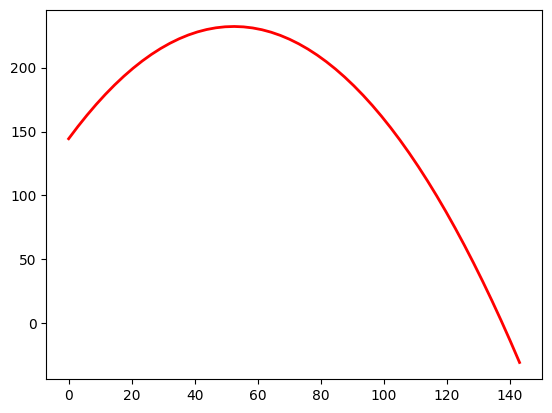

In [213]:
df_comments_tokens = df_comments_text[["tokens", 't']]
df_comments_tokens.dropna(inplace=True)

monthly_token_counts = df_comments_tokens.explode('tokens').groupby(['t', 'tokens']).size().reset_index(name='count_token')
top_tokens = monthly_token_counts['tokens'].value_counts().head(20).index

df_prepared_comments = monthly_token_counts[monthly_token_counts['tokens'].isin(top_tokens)]
poly_build(df_prepared_comments, 2, "count_token", "red" ,'')

In [214]:

monthly_token_counts = df_comments_text.explode("tokens").groupby(['t', "tokens"]).size().reset_index(name='count_token')
top_tokens = monthly_token_counts["tokens"].value_counts().head(20).index
monthly_token_counts = monthly_token_counts[monthly_token_counts["tokens"].isin(top_tokens)]
fig = px.line(
    monthly_token_counts,
    x='t',
    y='count_token',
    color="tokens",
    title=f'Изменение частотности токенов по месяцам для tokens',
    labels={'t': 'Месяц', 'count_token': 'Частотность'},
)
fig.update_xaxes(tickangle=45)
fig.show()

In [2]:
import pandas as pd
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.decomposition import LatentDirichletAllocation
import numpy as np
import matplotlib.pyplot as plt

# Предположим, что в df_comments_text есть столбец 'text' с сообщениями.
# Если необходимо, можно заполнить пропуски пустыми строками:
df_comments_text['text'] = df_comments_text['text'].fillna('')

# Шаг 1. Векторизация текстов
# Можно использовать CountVectorizer или TfidfVectorizer в зависимости от задачи
vectorizer = CountVectorizer(
    stop_words='english',    # или свой список стоп-слов
    min_df=5,               # отбрасываем редкие токены
    max_df=0.8,             # отбрасываем слишком частые токены
    ngram_range=(1,1)       # при необходимости увеличить до (1,2) или (1,3)
)
X = vectorizer.fit_transform(df_comments_text['text'])

# Шаг 2. Обучение LDA-модели
# n_components – число тем, подбирается экспериментально
n_topics = 5
lda_model = LatentDirichletAllocation(
    n_components=n_topics,
    random_state=42
)
lda_model.fit(X)

# Шаг 3. Просмотр ключевых слов для каждой темы
feature_names = vectorizer.get_feature_names_out()
n_top_words = 10  # число ключевых слов для вывода

for topic_idx, topic_dist in enumerate(lda_model.components_):
    # Получаем индексы топ-слов, сортируя по убыванию
    top_indices = topic_dist.argsort()[:-n_top_words - 1:-1]
    top_words = [feature_names[i] for i in top_indices]
    print(f"Topic {topic_idx}: {', '.join(top_words)}")

# Шаг 4. Назначение тем каждому документу
# Для каждой строки (сообщения) находим тему с максимальной вероятностью
topic_assignments = lda_model.transform(X)
df_comments_text['topic'] = topic_assignments.argmax(axis=1)

# Шаг 5. Отслеживание динамики тем во времени
# Предположим, что в df_comments_text есть столбец 't', указывающий месяц с начала наблюдений
topic_counts_by_month = df_comments_text.groupby(['t', 'topic']).size().reset_index(name='count')
# Преобразуем для удобства построения графиков (pivot)
topic_counts_pivot = topic_counts_by_month.pivot(index='t', columns='topic', values='count').fillna(0)

# Визуализация изменения частоты тем по месяцам
plt.figure(figsize=(10, 6))
for topic_idx in range(n_topics):
    plt.plot(topic_counts_pivot.index, topic_counts_pivot[topic_idx], label=f"Topic {topic_idx}")
plt.xlabel("Месяц (t)")
plt.ylabel("Частота")
plt.title("Динамика тем по месяцам")
plt.legend()
plt.show()


NameError: name 'df_comments_text' is not defined

# Анализ коммитов

In [14]:

from sklearn.preprocessing import MinMaxScaler, MaxAbsScaler
logs_list = []

for path in paths:
    try:
        commits = pd.read_csv(
            f"{path}/commits.csv"
        )
        commits["commit_date"] = pd.to_datetime(commits["commit_date"], utc=True)
        commits["create_date"] = pd.to_datetime(commits["create_date"], utc=True)
        commits.columns = ['commit_' + str(col) for col in commits.columns]
        commits = filter_time(commits, "commit_create_date")
        commits = filter_time(commits, "commit_commit_date")
        monthly_aggregation = commits.groupby(
        [pd.Grouper(key='commit_create_date', freq='M')]).agg(
            commit_stats_total=('commit_stats_total', 'sum'),
            commit_count=('commit_create_date', 'size')
        ).reset_index()
        
        scaler = MinMaxScaler()
        monthly_aggregation["commit_count"] = scaler.fit_transform(monthly_aggregation[['commit_count']])
        monthly_aggregation["commit_stats_total"] = scaler.fit_transform(monthly_aggregation[['commit_stats_total']])
        
        total = len(commits["commit_sha"].unique())
        total_changes = commits["commit_stats_total"].sum()
        monthly_aggregation['commit_count_percent'] = monthly_aggregation['commit_count'] * (100 / total)
        monthly_aggregation['commit_stats_total_percent'] = monthly_aggregation['commit_stats_total'] * (100 / total_changes)
        monthly_aggregation['t'] = ((monthly_aggregation['commit_create_date'] - monthly_aggregation['commit_create_date'].min()).dt.days / 30).astype('int')
    except Exception as e:
        print(e)
        continue
    logs_list.append(monthly_aggregation)

df_commits = pd.concat(logs_list, ignore_index=True)
df_commits.dropna(inplace=True)



Found array with 0 sample(s) (shape=(0, 1)) while a minimum of 1 is required by MinMaxScaler.


In [16]:
px.bar(
    df_commits.groupby('t')['commit_count'].mean().reset_index(),
    x='t',
    y="commit_count",
    title=f'Гистограмма зависимости коммитов от времени (среднее)',
    labels={'commit_count': 'Коммит', 't': 'месяц'},
    barmode='stack'
).show()
px.bar(
    df_commits.groupby('t')['commit_count_percent'].mean().reset_index(),
    x='t',
    y="commit_count_percent",
    title=f'Гистограмма зависимости процента внесенных коммитов от времени (среднее)',
    labels={'commit_count_percent': 'Процент', 't': 'месяц'},
    barmode='stack'
).show()
px.bar(
    df_commits.groupby('t')['commit_stats_total'].mean().reset_index(),
    x='t',
    y="commit_stats_total",
    title=f'Гистограмма зависимости объема внесенных изменений от времени (среднее)',
    labels={'commit_stats_total': 'Объем', 't': 'месяц'},
    barmode='stack'
).show()
px.bar(
    df_commits.groupby('t')['commit_stats_total_percent'].mean().reset_index().reset_index(),
    x='t',
    y="commit_stats_total_percent",
    title=f'Гистограмма зависимости процента объема внесенных изменений от времени (среднее)',
    labels={'commit_stats_total_percent': 'Процент', 't': 'месяц'},
    barmode='stack'
).show()

px.bar(
    df_commits.groupby('t')['commit_count'].sum().reset_index(),
    x='t',
    y="commit_count",
    title=f'Гистограмма зависимости коммитов от времени (суммарное)',
    labels={'commit_count': 'Коммит', 't': 'месяц'},
    barmode='stack'
).show()
px.bar(
    df_commits.groupby('t')['commit_count_percent'].sum().reset_index(),
    x='t',
    y="commit_count_percent",
    title=f'Гистограмма зависимости процента внесенных коммитов от времени (суммарное)',
    labels={'commit_count_percent': 'Процент', 't': 'месяц'},
    barmode='stack'
).show()
px.bar(
    df_commits.groupby('t')['commit_stats_total'].sum().reset_index(),
    x='t',
    y="commit_stats_total",
    title=f'Гистограмма зависимости объема внесенных изменений от времени (суммарное)',
    labels={'commit_stats_total': 'Объем', 't': 'месяц'},
    barmode='stack'
).show()
px.bar(
    df_commits.groupby('t')['commit_stats_total_percent'].sum().reset_index().reset_index(),
    x='t',
    y="commit_stats_total_percent",
    title=f'Гистограмма зависимости процента объема внесенных изменений от времени (суммарное)',
    labels={'commit_stats_total_percent': 'Процент', 't': 'месяц'},
    barmode='stack'
).show()

In [122]:

# from sklearn.preprocessing import MinMaxScaler, MaxAbsScaler


# for k, paths in {"community": community_paths, "solo": solo_paths,  "monarchist":monarchist_paths, "foundation":foundation_paths, "corporate":corporate_paths}.items():
#     logs_list = []
#     for path in paths:
#         try:
#             commits = pd.read_csv(
#                 f"{path}/commits.csv"
#             )
#         except Exception:
#             continue
#         commits["commit_date"] = pd.to_datetime(commits["commit_date"])
#         commits["create_date"] = pd.to_datetime(commits["create_date"])
#         commits.columns = ['commit_' + str(col) for col in commits.columns]
        
#         monthly_aggregation = commits.groupby(
#         [pd.Grouper(key='commit_create_date', freq='M')]).agg(
#             commit_stats_total=('commit_stats_total', 'sum'),
#             commit_count=('commit_create_date', 'size')
#         ).reset_index()
        
#         scaler = MinMaxScaler()
#         monthly_aggregation["commit_count"] = scaler.fit_transform(monthly_aggregation[['commit_count']])
#         monthly_aggregation["commit_stats_total"] = scaler.fit_transform(monthly_aggregation[['commit_stats_total']])
#         total = len(commits["commit_sha"].unique())
#         total_changes = commits["commit_stats_total"].sum()
#         monthly_aggregation['commit_count_percent'] = monthly_aggregation['commit_count'] * (100 / total)
#         monthly_aggregation['commit_stats_total_percent'] = monthly_aggregation['commit_stats_total'] * (100 / total_changes)
#         monthly_aggregation['t'] = ((monthly_aggregation['commit_create_date'] - monthly_aggregation['commit_create_date'].min()).dt.days / 30).astype('int')
        
#         logs_list.append(monthly_aggregation)

#     df_commits = pd.concat(logs_list, ignore_index=True)
#     df_commits.dropna(inplace=True)
#     print(f"\n{k}")
#     px.bar(
#         df_commits.groupby('t')['commit_count'].mean().reset_index(),
#         x='t',
#         y="commit_count",
#         title=f'Гистограмма зависимости коммитов времени (среднее)',
#         labels={'commit_count': 'Коммит', 't': 'месяц'},
#         barmode='stack'
#     ).show()
#     px.bar(
#         df_commits.groupby('t')['commit_count_percent'].mean().reset_index(),
#         x='t',
#         y="commit_count_percent",
#         title=f'Гистограмма зависимости процента внесенных коммитов времени (среднее)',
#         labels={'commit_count_percent': 'Процент', 't': 'месяц'},
#         barmode='stack'
#     ).show()
#     px.bar(
#         df_commits.groupby('t')['commit_stats_total'].mean().reset_index(),
#         x='t',
#         y="commit_stats_total",
#         title=f'Гистограмма зависимости объема внесенных изменений от времени (среднее)',
#         labels={'commit_stats_total': 'Объем', 't': 'месяц'},
#         barmode='stack'
#     ).show()
#     px.bar(
#         df_commits.groupby('t')['commit_stats_total_percent'].mean().reset_index().reset_index(),
#         x='t',
#         y="commit_stats_total_percent",
#         title=f'Гистограмма зависимости процента объема внесенных изменений от времени (среднее)',
#         labels={'commit_stats_total_percent': 'Процент', 't': 'месяц'},
#         barmode='stack'
#     ).show()

#     px.bar(
#         df_commits.groupby('t')['commit_count'].sum().reset_index(),
#         x='t',
#         y="commit_count",
#         title=f'Гистограмма зависимости коммитов времени (суммарное)',
#         labels={'commit_count': 'Коммит', 't': 'месяц'},
#         barmode='stack'
#     ).show()
#     px.bar(
#         df_commits.groupby('t')['commit_count_percent'].sum().reset_index(),
#         x='t',
#         y="commit_count_percent",
#         title=f'Гистограмма зависимости процента внесенных коммитов времени (суммарное)',
#         labels={'commit_count_percent': 'Процент', 't': 'месяц'},
#         barmode='stack'
#     ).show()
#     px.bar(
#         df_commits.groupby('t')['commit_stats_total'].sum().reset_index(),
#         x='t',
#         y="commit_stats_total",
#         title=f'Гистограмма зависимости объема внесенных изменений от времени (суммарное)',
#         labels={'commit_stats_total': 'Объем', 't': 'месяц'},
#         barmode='stack'
#     ).show()
#     px.bar(
#         df_commits.groupby('t')['commit_stats_total_percent'].sum().reset_index().reset_index(),
#         x='t',
#         y="commit_stats_total_percent",
#         title=f'Гистограмма зависимости процента объема внесенных изменений от времени (суммарное)',
#         labels={'commit_stats_total_percent': 'Процент', 't': 'месяц'},
#         barmode='stack'
#     ).show()



### Моделирование коммитов

In [124]:
df_prepared = df_commits.copy()

### Регрессия

In [167]:
df_prepared_commit = df_commits.groupby('t')['commit_count'].sum().reset_index()
X = df_prepared_commit[['t']].values
y = df_prepared_commit['commit_count'].values
X = sm.add_constant(X)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


lin_model = sm.OLS(y_train, X_train).fit()
y_pred_poly = lin_model.predict(X_test)

print("Polynomial Regression R-squared:", r2_score(y_test, y_pred_poly))
print("Polynomial Regression RMSE:", np.sqrt(mean_squared_error(y_test, y_pred_poly)))
print(lin_model.summary())

Polynomial Regression R-squared: 0.8489157844333255
Polynomial Regression RMSE: 1.229861735870044
                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.902
Model:                            OLS   Adj. R-squared:                  0.901
Method:                 Least Squares   F-statistic:                     1052.
Date:                Thu, 13 Mar 2025   Prob (F-statistic):           2.14e-59
Time:                        17:23:34   Log-Likelihood:                -166.24
No. Observations:                 116   AIC:                             336.5
Df Residuals:                     114   BIC:                             342.0
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------

Decision Tree R-squared: 0.918224367510394
Decision Tree RMSE: 0.9048127226368502


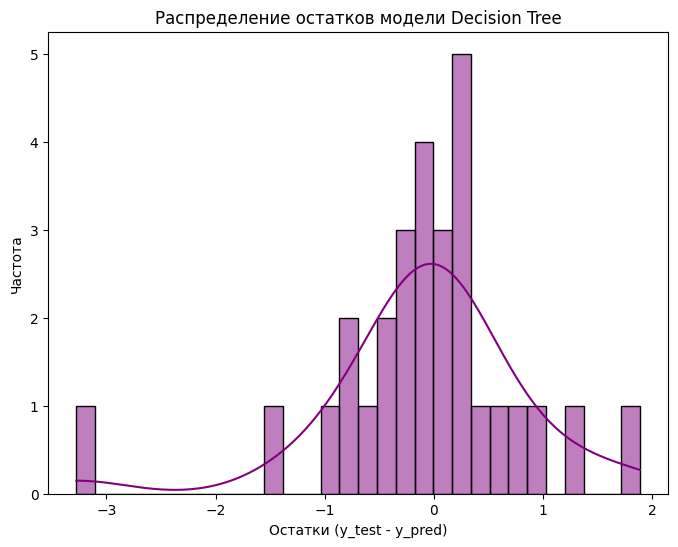

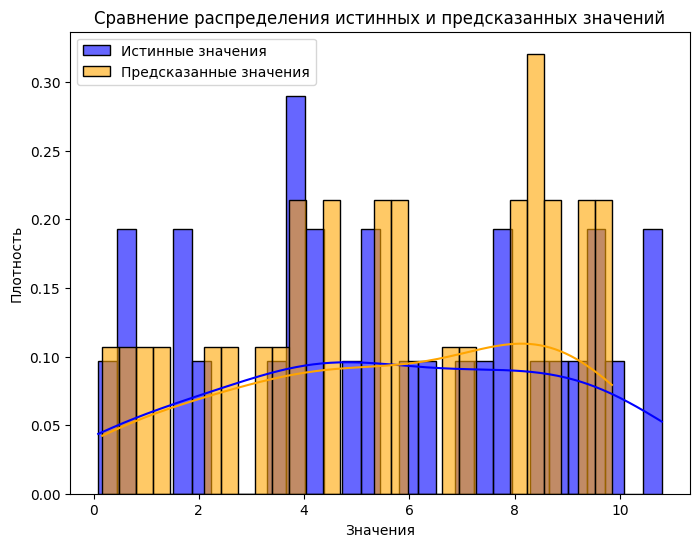

In [166]:
df_prepared_commit = df_commits.groupby('t')['commit_count'].sum().reset_index()
X = df_prepared_commit[['t']].values
y = df_prepared_commit['commit_count'].values

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

tree_model = DecisionTreeRegressor(random_state=42)
tree_model.fit(X_train, y_train)
y_pred_tree = tree_model.predict(X_test)
print("Decision Tree R-squared:", r2_score(y_test, y_pred_tree))
print("Decision Tree RMSE:", np.sqrt(mean_squared_error(y_test, y_pred_tree)))

residuals = y_test - y_pred_tree

plt.figure(figsize=(8, 6))
sns.histplot(residuals, kde=True, color='purple', bins=30)
plt.title("Распределение остатков модели Decision Tree")
plt.xlabel("Остатки (y_test - y_pred)")
plt.ylabel("Частота")
plt.show()

plt.figure(figsize=(8, 6))
sns.histplot(y_test, color='blue', label='Истинные значения', kde=True, stat="density", bins=30, alpha=0.6)
sns.histplot(y_pred_tree, color='orange', label='Предсказанные значения', kde=True, stat="density", bins=30, alpha=0.6)
plt.title("Сравнение распределения истинных и предсказанных значений")
plt.xlabel("Значения")
plt.ylabel("Плотность")
plt.legend()
plt.show()


Polynomial Regression R-squared: 0.8817630159308105
Polynomial Regression RMSE: 1.0879862691055266
                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.931
Model:                            OLS   Adj. R-squared:                  0.927
Method:                 Least Squares   F-statistic:                     244.5
Date:                Thu, 13 Mar 2025   Prob (F-statistic):           8.04e-61
Time:                        17:20:39   Log-Likelihood:                -146.17
No. Observations:                 116   AIC:                             306.3
Df Residuals:                     109   BIC:                             325.6
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------

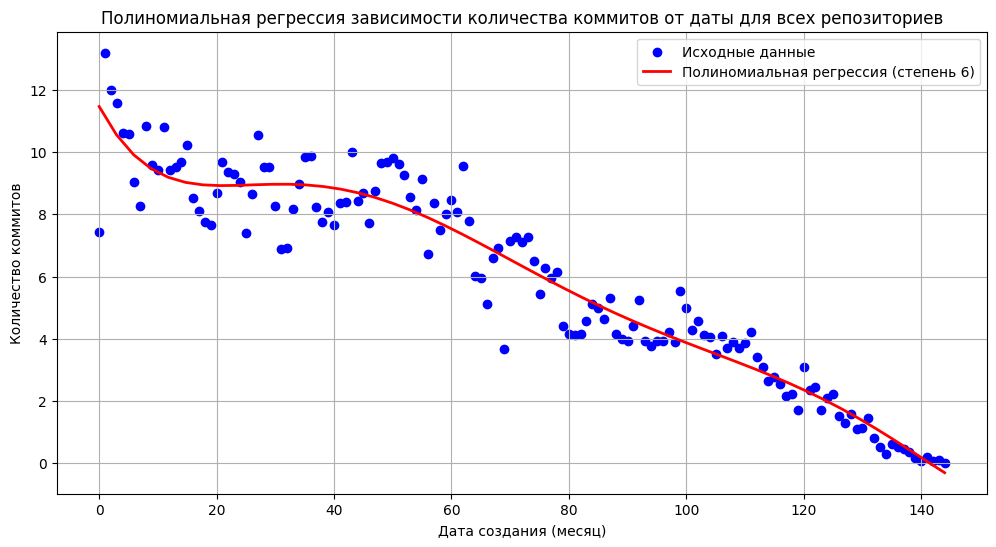

In [155]:
df_prepared_commit = df_commits.groupby('t')['commit_count'].sum().reset_index()
X = df_prepared_commit[['t']].values
y = df_prepared_commit['commit_count'].values

degree = 6
poly = PolynomialFeatures(degree)
X_poly = poly.fit_transform(X)
X_train_poly, X_test_poly, y_train, y_test = train_test_split(X_poly, y, test_size=0.2, random_state=42)

poly_model = sm.OLS(y_train, X_train_poly).fit()
y_pred_poly = poly_model.predict(X_test_poly)

print("Polynomial Regression R-squared:", r2_score(y_test, y_pred_poly))
print("Polynomial Regression RMSE:", np.sqrt(mean_squared_error(y_test, y_pred_poly)))
print(poly_model.summary())
t_range = np.linspace(X.min(), X.max()).reshape(-1, 1)
t_range_poly = poly.transform(t_range)
y_pred = poly_model.predict(t_range_poly)

plt.figure(figsize=(12, 6))
plt.scatter(df_prepared_commit['t'], y, color='blue', label="Исходные данные")

plt.plot(t_range, y_pred, color='red', linewidth=2, label="Полиномиальная регрессия (степень {})".format(degree))
plt.xlabel("Дата создания (месяц)")
plt.ylabel("Количество коммитов")
plt.title("Полиномиальная регрессия зависимости количества коммитов от даты для всех репозиториев")
plt.legend()
params = poly_model.params

equation = f"y = ({params[0]:.10f})"
for i, coef in enumerate(params[1:], start=1):
    equation += f" + ({coef:.10f})*x{i}"
print("Уравнение модели:")
print(equation)

plt.grid(True)
plt.show()



In [58]:
# df_prepared_commit = df_commits.groupby('t')['commit_count'].sum().reset_index()

# X = df_prepared_commit[['t']].values
# y = df_prepared_commit['commit_count'].values

# degree = 4
# poly = PolynomialFeatures(degree)
# X_poly = poly.fit_transform(X)
# X_train_poly, X_test_poly, y_train, y_test = train_test_split(X_poly, y, test_size=0.2, random_state=42)

# poly_model = LinearRegression(fit_intercept=False).fit(X_train_poly, y_train)
# y_pred_poly = poly_model.predict(X_test_poly)

# print("Polynomial Regression R-squared:", r2_score(y_test, y_pred_poly))
# print("Polynomial Regression RMSE:", np.sqrt(mean_squared_error(y_test, y_pred_poly)))
# print("Коэффициенты модели (полиномиальная регрессия, степень {}):".format(degree))
# print("Свободный член (intercept): {:.3f}".format(poly_model.intercept_))
# for power, coef in enumerate(poly_model.coef_, start=1):
#     print("Коэффициент при t^{} = {:.10f}".format(power, coef))


# t_range = np.linspace(X.min(), X.max()).reshape(-1, 1)
# t_range_poly = poly.transform(t_range)
# y_pred = poly_model.predict(t_range_poly)

# plt.figure(figsize=(12, 6))
# plt.scatter(df_prepared_commit['t'], y, color='blue', label="Исходные данные")

# plt.plot(t_range, y_pred, color='red', linewidth=2, label="Полиномиальная регрессия (степень {})".format(degree))
# plt.xlabel("Дата создания (месяц)")
# plt.ylabel("Количество коммитов")
# plt.title("Полиномиальная регрессия зависимости количества коммитов от даты для всех репозиториев")
# plt.legend()
# plt.grid(True)
# plt.show()


Polynomial Regression R-squared: 0.6692025039752925
Polynomial Regression RMSE: 0.5488134605733844
                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.701
Model:                            OLS   Adj. R-squared:                  0.684
Method:                 Least Squares   F-statistic:                     42.52
Date:                Thu, 13 Mar 2025   Prob (F-statistic):           2.21e-26
Time:                        17:56:40   Log-Likelihood:                -112.84
No. Observations:                 116   AIC:                             239.7
Df Residuals:                     109   BIC:                             258.9
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------

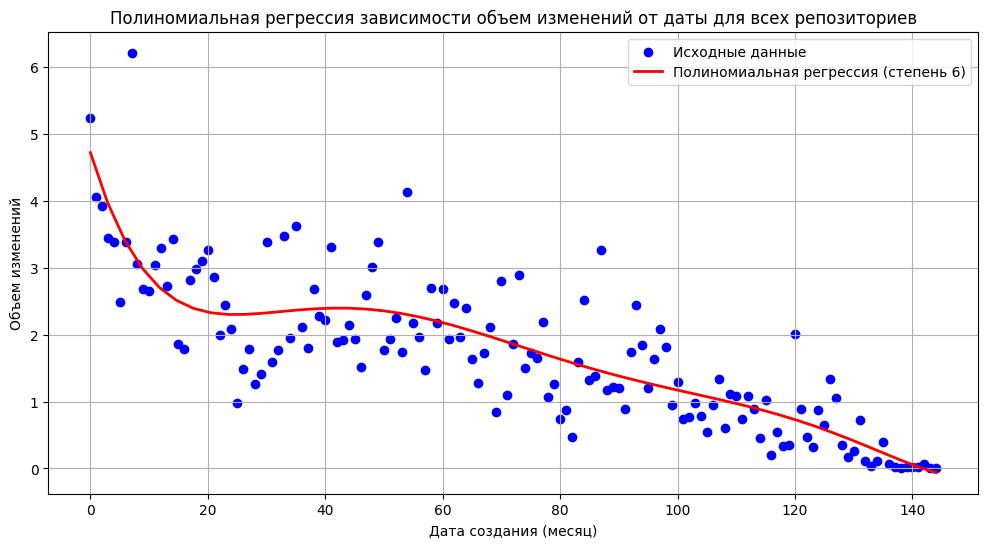

In [168]:
df_prepared_commit = df_prepared.groupby('t')['commit_stats_total'].sum().reset_index()
X = df_prepared_commit[['t']].values
y = df_prepared_commit['commit_stats_total'].values

degree = 6
poly = PolynomialFeatures(degree)
X_poly = poly.fit_transform(X)
X_train_poly, X_test_poly, y_train, y_test = train_test_split(X_poly, y, test_size=0.2, random_state=42)

poly_model = sm.OLS(y_train, X_train_poly).fit()
y_pred_poly = poly_model.predict(X_test_poly)

print("Polynomial Regression R-squared:", r2_score(y_test, y_pred_poly))
print("Polynomial Regression RMSE:", np.sqrt(mean_squared_error(y_test, y_pred_poly)))
print(poly_model.summary())
t_range = np.linspace(X.min(), X.max()).reshape(-1, 1)
t_range_poly = poly.transform(t_range)
y_pred = poly_model.predict(t_range_poly)

plt.figure(figsize=(12, 6))
plt.scatter(df_prepared_commit['t'], y, color='blue', label="Исходные данные")

plt.plot(t_range, y_pred, color='red', linewidth=2, label="Полиномиальная регрессия (степень {})".format(degree))
plt.xlabel("Дата создания (месяц)")
plt.ylabel("Объем изменений")
plt.title("Полиномиальная регрессия зависимости объем изменений от даты для всех репозиториев")
plt.legend()
params = poly_model.params

equation = f"y = ({params[0]:.10f})"
for i, coef in enumerate(params[1:], start=1):
    equation += f" + ({coef:.10f})*x{i}"
print("Уравнение модели:")
print(equation)

plt.grid(True)
plt.show()


# Анализ пользователей

In [88]:
from sklearn.preprocessing import MinMaxScaler
logs_list = []
user_log = []
for path in community_paths + solo_paths + monarchist_paths + corporate_paths:
    try:
        commits = pd.read_csv(
            f"{path}/commits.csv"
        )
    except Exception:
        continue
    commits["commit_date"] = pd.to_datetime(commits["commit_date"])
    commits["create_date"] = pd.to_datetime(commits["create_date"])
    commits.columns = ['commit_' + str(col) for col in commits.columns]
    commits["repo"] = path.split("/")[-2]
    
    # monthly_aggregation = commits.groupby(
    # [pd.Grouper(key='commit_create_date', freq='M')]).agg(
    #     commit_author_count=('commit_author_id', 'size')
    # ).reset_index()
    
    # scaler = MinMaxScaler()
    # monthly_aggregation["commit_author_count"] = scaler.fit_transform(monthly_aggregation[['commit_author_count']])
    # monthly_aggregation['t'] = ((monthly_aggregation['commit_create_date'] - monthly_aggregation['commit_create_date'].min()).dt.days / 30).astype('int')
    logs_list.append(commits)
    try:
        user = pd.read_csv(
    f"{path}/user-commit.csv"
)
    except Exception:
        continue
    user["date"] = pd.to_datetime(user["date"])
    user.columns = ['user_' + str(col) for col in user.columns]
    user["action"] = "user"
    user["sha"] = user["user_commit_sha"]
    user_log.append(user)

df_commits = pd.concat(logs_list, ignore_index=True)
df_commits.dropna(inplace=True)
df_users = pd.concat(user_log, ignore_index=True)
df_users.dropna(inplace=True)
df_prepared_users = df_commits.copy()
# df_prepared_users = df_prepared_users.groupby('t')['commit_author_count'].mean().reset_index()

In [89]:
robots = df_users[(
    df_users["user_login"].str.contains("robot", case=False))
    | (df_users["user_name"].str.contains("robot", case=False))
]["user_id"].unique().tolist()

robots.append(-1.0)

filtered_data = df_commits.dropna(subset=['commit_author_id'])
filtered_data.drop(filtered_data[filtered_data["commit_author_id"].isin(robots)].index, inplace=True)
#filtered_data['commit_author_id'] = filtered_data['commit_author_id'].astype(str)

repo_user_aggregation = filtered_data.groupby(
    [pd.Grouper(key='repo'), pd.Grouper(key='commit_author_id')]).agg(
        commit_stats_total=('commit_stats_total', 'sum'),
        commit_count=('commit_create_date', 'size')
    )
    
author_stats = filtered_data['commit_author_id'].value_counts()
print("Количество коммитов по авторам:")
print(author_stats.describe())

fig = px.histogram(
    author_stats.reset_index(name='count')['count'],
    title='Распределение количества коммитов по авторам',
    labels={'count': 'Количество коммитов', 'index': 'Количество авторов'},
)

fig.update_layout(
    xaxis_title='Количество коммитов',
    yaxis_title='Количество авторов',
    bargap=0.1
)
fig.show()


authors_cnt_commit = filtered_data.groupby('commit_author_id').size().reset_index(name='author_count')
authors_changes = filtered_data.groupby('commit_author_id')['commit_stats_total'].sum().reset_index(name='author_change')

authors_stat = authors_changes.merge(authors_cnt_commit, on="commit_author_id", how="inner").reset_index()
authors_stat["author_commit_count_percent"] = authors_stat["author_count"] * 100 / filtered_data.shape[0]
authors_stat["author_commit_changes_percent"] = authors_stat["author_change"] * 100 / filtered_data["commit_stats_total"].sum()

fig = px.scatter(
    authors_stat,
    y='author_change',
    x='author_count',
    title='Зависимость суммарного количества коммитов и их объема для каждого автора',
)
fig.show()

fig = px.scatter(
    authors_stat,
    y='author_commit_changes_percent',
    x='author_commit_count_percent',
    title='Зависимость суммарного количества коммитов и их объема для каждого автора в процентном соотношении',
)
fig.show()

Количество коммитов по авторам:
count    19450.000000
mean        23.659075
std        217.817128
min          1.000000
25%          1.000000
50%          1.000000
75%          3.000000
max       8274.000000
Name: count, dtype: float64


In [90]:
robots = df_users[(
    df_users["user_login"].str.contains("robot", case=False))
    | (df_users["user_name"].str.contains("robot", case=False))
]["user_id"].unique().tolist()

robots.append(-1.0)

filtered_data = df_commits.dropna(subset=['commit_author_id'])
filtered_data.drop(filtered_data[filtered_data["commit_author_id"].isin(robots)].index, inplace=True)
#filtered_data['commit_author_id'] = filtered_data['commit_author_id'].astype(str)

repo_user_aggregation = filtered_data.groupby(
    [pd.Grouper(key='repo'), pd.Grouper(key='commit_author_id')]).agg(
        commit_stats_total=('commit_stats_total', 'sum'),
        commit_count=('commit_create_date', 'size')
    )
fig = px.scatter(
    repo_user_aggregation.reset_index(),
    x='commit_stats_total',
    y='commit_count',
    color='repo',
    hover_data=['commit_author_id'],
    title="Объем изменений и количество коммитов для авторов по репозиториям"
).show()



In [91]:



repo_total_user = repo_user_aggregation.groupby("repo")["commit_stats_total"].sum().reset_index()
repo_user_aggregation_percent = repo_user_aggregation.merge(repo_total_user, on="repo", how="inner")
repo_user_aggregation_percent["commit_stats_total_percent"] = (100 * (repo_user_aggregation_percent["commit_stats_total_x"] / repo_user_aggregation_percent["commit_stats_total_y"])) //1

In [92]:
len(repo_user_aggregation_percent[repo_user_aggregation_percent["commit_stats_total_percent"] < 1]) / len(repo_user_aggregation_percent)

0.9768126281994114

In [93]:
len(repo_user_aggregation_percent[repo_user_aggregation_percent["commit_stats_total_percent"] >= 1]) / len(repo_user_aggregation_percent)

0.023187371800588604

In [75]:
# процент вносимы о авторам
rt = repo_user_aggregation_percent[repo_user_aggregation_percent["commit_stats_total_percent"] >= 0].groupby('commit_stats_total_percent')["commit_stats_total_percent"].count().reset_index(name="count")

In [94]:
rt

,commit_stats_total_percent,count
0,0.0,21899
1,1.0,175
2,2.0,82
3,3.0,43
4,4.0,34
5,5.0,20
6,6.0,16
7,7.0,8
8,8.0,10
9,9.0,10


In [95]:
rt_20 = repo_user_aggregation_percent[repo_user_aggregation_percent["commit_stats_total_percent"] > 20].groupby('commit_stats_total_percent')["commit_stats_total_percent"].count().reset_index(name="count")
rt_20.describe()

,commit_stats_total_percent,count
count,50.000000,50.000000
mean,60.140000,1.660000
std,25.348196,1.002242
min,21.000000,1.000000
25%,36.750000,1.000000
50%,63.000000,1.000000
75%,83.750000,2.000000
max,99.000000,6.000000


In [96]:
rt_1 = repo_user_aggregation_percent[repo_user_aggregation_percent["commit_stats_total_percent"] <=1].groupby('commit_stats_total_percent')["commit_stats_total_percent"].count().reset_index(name="count")
rt_1

,commit_stats_total_percent,count
0,0.0,21906
1,1.0,175


In [97]:
fig = px.bar(
    rt,
    # color='repo',
    y='count',
    x='commit_stats_total_percent',
    title="Объем изменений для авторов",
    labels={'count': 'Количество авторов', 'commit_stats_total_percent': 'Процент от всего объема изменений в репозитории'},
).show()

In [ ]:
px.bar(
    df_prepared_users.groupby('t')['commit_author_count'].mean().reset_index(),
    x='t',
    y="commit_author_count",
    title=f'Гистограмма зависимости количества разрабтчиков (среднее)',
    labels={'commit_author_count': 'Количество разработчиков', 't': 'месяц'},
    barmode='stack'
).show()

# Времянные ряды

### Анализ коммитов

In [170]:
from sklearn.preprocessing import MinMaxScaler
logs_list = []
for path in community_paths + solo_paths + monarchist_paths + foundation_paths + corporate_paths:
    try:
        commits = pd.read_csv(
            f"{path}/commits.csv"
        )
    except Exception:
        continue
    commits["commit_date"] = pd.to_datetime(commits["commit_date"])
    commits["create_date"] = pd.to_datetime(commits["create_date"])
    commits.columns = ['commit_' + str(col) for col in commits.columns]
    commits = filter_time(commits, "commit_create_date")
    commits = filter_time(commits, "commit_commit_date")
    
    monthly_aggregation = commits.groupby(
    [pd.Grouper(key='commit_create_date', freq='M')]).agg(
        commit_stats_total=('commit_stats_total', 'sum'),
        commit_count=('commit_create_date', 'size')
    ).reset_index()
    
    scaler = MinMaxScaler()
    monthly_aggregation["commit_count"] = scaler.fit_transform(monthly_aggregation[['commit_count']])
    #monthly_aggregation["commit_stats_total"] = scaler.fit_transform(monthly_aggregation[['commit_stats_total']])
    monthly_aggregation['t'] = ((monthly_aggregation['commit_create_date'] - monthly_aggregation['commit_create_date'].min()).dt.days / 30).astype('int')
    logs_list.append(monthly_aggregation)

df_commits_ts = pd.concat(logs_list, ignore_index=True)
df_commits_ts.dropna(inplace=True)
df_prepared_ts = df_commits_ts.copy()
# df_prepared_ts = df_prepared_ts.set_index('t')
df_prepared_ts = df_commits_ts.groupby('t')['commit_count'].sum().reset_index()



In [82]:

from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.stattools import acf, pacf
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.arima.model import ARIMA

warnings.filterwarnings("ignore")

print('Результат теста:')
df_result = adfuller(df_prepared_ts['commit_count'])
df_labels = ['ADF Test Statistic', 'p-value', '#Lags Used', 'Number of Observations Used']
for result_value, label in zip(df_result, df_labels):
    print(label + ' : ' + str(result_value))

if df_result[1] <= 0.05:
    print("Сильные доказательства против нулевой гипотезы, ряд является стационарным.")
else:
    print("Слабые доказательства против нулевой гипотезы, ряд не является стационарным.")

Результат теста:
ADF Test Statistic : -1.4601902047753752
p-value : 0.5531047954553546
#Lags Used : 9
Number of Observations Used : 165
Слабые доказательства против нулевой гипотезы, ряд не является стационарным.


In [204]:
from pmdarima import auto_arima
ts = pd.Series(df_prepared_ts['commit_count'], index=df_prepared_ts['t'])
ts.dropna(inplace=True)

auto_model = auto_arima(ts, start_p=0, start_q=0,
                        max_p=5, max_q=5, m=1,   # m - сезонный период, если нет сезонности, m=1
                        start_P=0, seasonal=False,   # если сезонности нет
                        d=None,           # d определится автоматически (auto_arima попробует тестировать)
                        trace=True,
                        error_action='ignore',  
                        suppress_warnings=True,
                        stepwise=True)
print(auto_model.summary())

Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=807.802, Time=0.01 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=795.793, Time=0.02 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=785.327, Time=0.01 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=807.566, Time=0.00 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=780.562, Time=0.07 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=782.181, Time=0.05 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=782.080, Time=0.03 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=780.629, Time=0.02 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=786.188, Time=0.02 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=784.078, Time=0.06 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=789.379, Time=0.05 sec

Best model:  ARIMA(1,1,1)(0,0,0)[0] intercept
Total fit time: 0.347 seconds
                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:                  175
Model: 

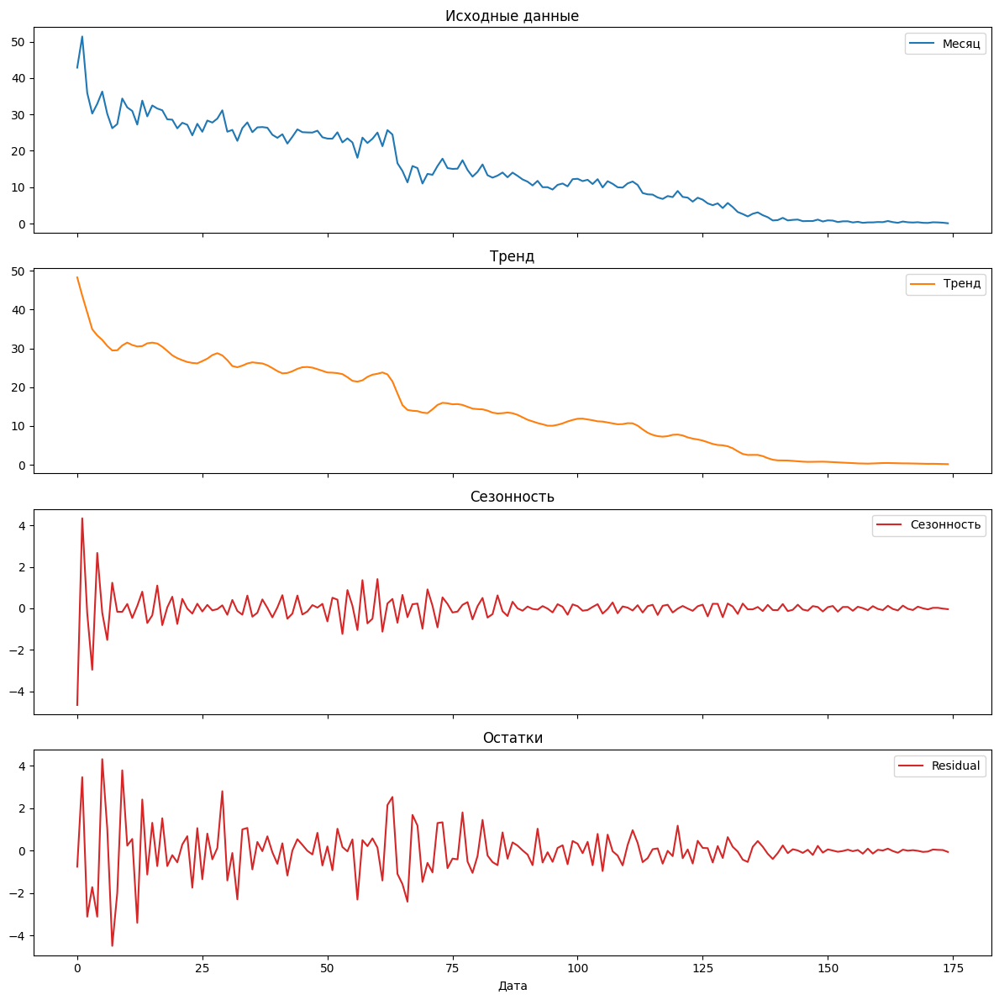

In [177]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.stattools import adfuller, acf
from statsmodels.tsa.seasonal import STL
from statsmodels.tsa.arima.model import ARIMA
from sklearn.metrics import mean_absolute_error, mean_squared_error

ts = pd.Series(df_prepared_ts['commit_count'], index=df_prepared_ts['t'])
ts.dropna(inplace=True)
stl = STL(ts, period=3)
stl_result = stl.fit()
# stl_result.plot()
fig, axes = plt.subplots(4,1, figsize=(12,12), sharex=True)

axes[0].plot(ts.index, ts, label= 'Месяц')
axes[0].set_title('Исходные данные')
axes[0].legend()

axes[1].plot(ts.index, stl_result.trend, label='Тренд', color='C1')
axes[1].set_title('Тренд')
axes[1].legend()

axes[2].plot(ts.index, stl_result.seasonal, label='Сезонность', color='C3')
axes[2].set_title('Сезонность')
axes[2].legend()

axes[3].plot(ts.index, stl_result.resid, label='Residual', color='C3')
axes[3].set_title('Остатки')
axes[3].legend()

plt.xlabel('Дата')
plt.tight_layout()
plt.show()


In [206]:
seasonal_std = stl_result.seasonal.std()
print("Standard Deviation of Seasonal Component:", seasonal_std)

Standard Deviation of Seasonal Component: 0.7032678008878773


# Анализ панельных данных

In [52]:
from sklearn.preprocessing import MinMaxScaler
logs_list = []

# for path in community_paths + solo_paths + monarchist_paths + foundation_paths + corporate_paths:
for path in solo_paths:
    try:
        commits = pd.read_csv(
            f"{path}/commits.csv"
        )
    except Exception:
        continue
    commits["commit_date"] = pd.to_datetime(commits["commit_date"])
    commits["create_date"] = pd.to_datetime(commits["create_date"])
    commits.columns = ['commit_' + str(col) for col in commits.columns]
    
    monthly_aggregation = commits.groupby(
    [pd.Grouper(key='commit_create_date', freq='M')]).agg(
        commit_stats_total=('commit_stats_total', 'sum'),
        commit_count=('commit_create_date', 'size')
    ).reset_index()
    monthly_aggregation["repo"] = path.split("/")[-2]
    
    scaler = MinMaxScaler()
    monthly_aggregation["commit_count"] = scaler.fit_transform(monthly_aggregation[['commit_count']])
    monthly_aggregation["commit_stats_total"] = scaler.fit_transform(monthly_aggregation[['commit_stats_total']])
    monthly_aggregation['t'] = ((monthly_aggregation['commit_create_date'] - monthly_aggregation['commit_create_date'].min()).dt.days / 30).astype('int')
    logs_list.append(monthly_aggregation)

df_commits = pd.concat(logs_list, ignore_index=True)
df_commits.dropna(inplace=True)
# df_panel_prepared = df_commits.groupby('t')['commit_count'].sum()
df_commits["time"] = df_commits["t"]
df_panel_prepared = df_commits.set_index(['repo', 't'])



In [56]:
print(df_panel_prepared.head())

              commit_create_date  commit_stats_total  commit_count  time
repo t                                                                  
fx   0 2018-01-31 00:00:00+00:00            0.041439      0.150794     0
     0 2018-02-28 00:00:00+00:00            0.000000      0.000000     0
     1 2018-03-31 00:00:00+00:00            0.006626      0.063492     1
     2 2018-04-30 00:00:00+00:00            0.000000      0.000000     2
     4 2018-05-31 00:00:00+00:00            0.000000      0.000000     4


In [109]:
from statsmodels.tools import add_constant

X = df_panel_prepared[['time']]
y = df_panel_prepared['commit_count']

#X = add_constant(X)

pooled_ols_model = PanelOLS(y, sm.add_constant(X), entity_effects=False).fit()
fixed_effects_model = PanelOLS(y, sm.add_constant(X), entity_effects=True).fit()

# При BetweenOLS не добавляем константу!
random_model = RandomEffects(y, X).fit()
between_ols_model = BetweenOLS(y, X).fit()

model_comparison = compare({'Pooled OLS': pooled_ols_model, "fixed_effects_model": fixed_effects_model, "between_ols_model": between_ols_model, "random_model": random_model})

print(model_comparison)
# print("Pooled OLS model\n", pooled_ols_model.summary)
# print("Fixed effects model:\n", fixed_effects_model.summary)
# print("Random effects model:\n", random_effects_model.summary)

                                        Model Comparison                                        
                              Pooled OLS fixed_effects_model between_ols_model      random_model
------------------------------------------------------------------------------------------------
Dep. Variable               commit_count        commit_count      commit_count      commit_count
Estimator                       PanelOLS            PanelOLS        BetweenOLS     RandomEffects
No. Observations                     192                 192                 2               192
Cov. Est.                     Unadjusted          Unadjusted        Unadjusted        Unadjusted
R-squared                         0.0097              0.0237            0.9996            0.2151
R-Squared (Within)                0.0201              0.0237           -0.3281           -0.1740
R-Squared (Between)              -0.5950             -1.0058            0.9996            0.8852
R-Squared (Overall)           

In [ ]:

y = df_panel_prepared['commit_count']

# В качестве объясняющей переменной используем time (нормализованный порядковый номер недели).
# Добавляем константу.
exog = sm.add_constant(df_panel_prepared[['commit_stats_total']], has_constant='add')

# Оценка модели панельной регрессии с фиксированными эффектами по репозиториям (entity_effects)
# Это позволяет учитывать особенности каждого репозитория, которые не меняются со временем.
mod = PanelOLS(y, exog, entity_effects=True,  time_effects=True)

# Если вы также хотите учесть общие временные эффекты, можно добавить time_effects=True:
# mod = PanelOLS(y, exog, entity_effects=True, time_effects=True)

# Оценка модели
res = mod.fit(cov_type='clustered', cluster_entity=True)  # кластеризация по репозиториям для более надежных стандартных ошибок

# Вывод результатов
print(res.summary)


# Релизы

In [61]:
# def analyze_releases(path):
#     release = pd.read_csv(
#     f"{path}/release-commit.csv"
# )
#     release["created_at"] = pd.to_datetime(release["created_at"])
#     release["published_at"] = pd.to_datetime(release["published_at"])
#     release.columns = ['release_' + str(col) for col in release.columns]
#     release["sha"] = release["release_commit_sha"]
#     release["action"] = "release"
    
#     df_releases = release.copy()

#     monthly_aggregation = df_releases.groupby([pd.Grouper(key='release_created_at', freq='M')]).size().reset_index(name='release_count')
#     total = len(df_releases["sha"].unique())
#     monthly_aggregation['release_count_percent'] = monthly_aggregation['release_count'] * (100 / total)

#     px.bar(
#         monthly_aggregation.reset_index(),
#         x='release_created_at',
#         y="release_count_percent",
#         title=f'{path.split("/")[-2]} Процент созданных релизов по времени',
#         labels={'release_count_percent': 'процент количества релизов от общего', 'release_created_at': 'месяц'},
#         barmode='stack'
#     ).show()
#     df_releases["release_publish_create_dif"]=(df_releases["release_published_at"] - df_releases["release_created_at"]).dt.total_seconds()

# #df_releases_time = df_releases[df_releases["release_publish_create_dif"] >= 0]
#     px.bar(
#         df_releases,
#         x='release_created_at',
#         y='release_publish_create_dif',
#         title=f'{path.split("/")[-2]} Время между созданием релиза и публикацией',
#         labels={'release_publish_create_dif': 'Промежуток времени в днях', 'release_created_at': 'Дата публикации'},
#         barmode='stack'
#     ).show()
    
#     # fig = px.histogram(
#     #     df_releases,
#     #     x='release_publish_create_dif',
#     #     title='Время между созданием релиза и публикацией',
#     #     labels={'release_publish_create_dif': 'Промежуток времени в днях', 'release_count': 'Количество релизов'},
#     # )
#     # print(df_releases.groupby('release_author_id').size().reset_index(name="release_count").sort_values(by="release_count", ascending=0))
    
#     # robots = df_user[(
#     #     df_user["user_login"].str.contains("robot", case=False))
#     #     | (df_user["user_name"].str.contains("robot", case=False))
#     # ]["user_id"].unique().tolist()

#     # robots.append(-1.0)

#     # filtered_data = df_commit.dropna(subset=['commit_author_id'])
#     # filtered_data.drop(filtered_data[filtered_data["commit_author_id"].isin(robots)].index, inplace=True)
#     # #filtered_data['commit_author_id'] = filtered_data['commit_author_id'].astype(str)

#     author_stats = df_releases['release_author_id'].value_counts()
#     px.histogram(
#         author_stats.reset_index(name='count')['count'],
#         title=f'{path.split("/")[-2]} Распределение количества релизов по авторам',
#         labels={'count': 'Количество коммитов', 'index': 'Количество авторов'},
#         nbins=30
#     ).show()
#     print(author_stats.reset_index(name='count')['count'])
    
#     monthly_aggregation = df_releases.groupby([
#         pd.Grouper(key='release_created_at', freq='M'), 'release_author_id'
#     ]).agg(
#         release_author_count=('release_author_id', 'count'),
#     ).unstack(fill_value=0)

#     monthly_aggregation.columns = monthly_aggregation.columns.droplevel(0)

#     fig = go.Figure()
#     for t in df_releases["release_author_id"].unique():
#         fig.add_trace(go.Scatter(
#             x=monthly_aggregation.index,
#             y=monthly_aggregation[t],
#             mode='lines',
#             name=f'{t}',
#         ))

#     fig.update_layout(
#         title=f'{path.split("/")[-2]} Авторы релизов',
#         xaxis_title='Дата',
#         yaxis_title='Количество релизов автора',
#         hovermode='x unified',
#     ).show()

In [83]:
from sklearn.preprocessing import MinMaxScaler, MaxAbsScaler

logs = []
for path in paths:
    try:
        release = pd.read_csv(
    f"{path}/release-commit.csv"
    )
    except Exception:
        continue
    if len(release) == 0:
        continue
    release["created_at"] = pd.to_datetime(release["created_at"])
    release["published_at"] = pd.to_datetime(release["published_at"])
    release.columns = ['release_' + str(col) for col in release.columns]
    release["sha"] = release["release_commit_sha"]
    monthly_aggregation = release.groupby([pd.Grouper(key='release_created_at', freq='M')]).agg(release_count=('release_created_at', 'size')).reset_index()
    monthly_aggregation["release_count"]=  MinMaxScaler().fit_transform(monthly_aggregation[['release_count']])
    # total = len(release["release_id"].unique())
    # if total == 0:
    #     monthly_aggregation['release_count_percent'] = 0
    # else:
    #     monthly_aggregation['release_count_percent'] = monthly_aggregation['release_count'] * (100 / total)
    monthly_aggregation['t'] = ((monthly_aggregation['release_created_at'] - monthly_aggregation['release_created_at'].min()).dt.days / 30).astype('int')
    logs.append(monthly_aggregation)

df_releases = pd.concat(logs, ignore_index=True)

px.bar(
    df_releases.groupby("t")["release_count"].sum().reset_index(),
    x='t',
    y="release_count",
    title=f'Распределение релизов по времени',
    labels={'release_count': 'количества релизов', 't': 'месяц'},
).show()

In [88]:
logs = []
for path in community_paths + solo_paths + monarchist_paths + foundation_paths + corporate_paths:
    try:
        release = pd.read_csv(
    f"{path}/release-commit.csv"
    )
    except Exception:
        continue
    release["created_at"] = pd.to_datetime(release["created_at"])
    release["published_at"] = pd.to_datetime(release["published_at"])
    release.columns = ['release_' + str(col) for col in release.columns]
    release["sha"] = release["release_commit_sha"]
    release["action"] = "release"
    logs.append(release)

df_releases_time = pd.concat(logs, ignore_index=True)
df_releases_time["release_created_at"] = pd.to_datetime(df_releases_time["release_created_at"])
df_releases_time["release_published_at"] = pd.to_datetime(df_releases_time["release_published_at"])
df_releases_time["release_publish_create_dif"]=(df_releases_time["release_published_at"] - df_releases_time["release_created_at"]).dt.days
df_releases_time["release_publish_create_dif_min"]=((df_releases_time["release_published_at"] - df_releases_time["release_created_at"]).dt.total_seconds() // 60).astype("int")

df_releases_time_f = df_releases_time[df_releases_time["release_publish_create_dif"] >= 0]
df_releases_time_f = df_releases_time_f[df_releases_time_f["release_publish_create_dif"] <= 1000]

print(len(df_releases_time_f))
fig = px.histogram(
    df_releases_time_f,
    x='release_publish_create_dif',
    title='Время между созданием релиза и публикацией',
    labels={'release_publish_create_dif': 'Промежуток времени в днях', 'release_count': 'Количество релизов'},
).show()


df_releases_time_f = df_releases_time[df_releases_time["release_publish_create_dif_min"] >= 0]
df_releases_time_f = df_releases_time_f[df_releases_time_f["release_publish_create_dif_min"] <= 60 *24]
print(len(df_releases_time_f))
fig = px.histogram(
    df_releases_time_f,
    histfunc="count",
    x='release_publish_create_dif_min',
    title='Время между созданием релиза и публикацией',
    labels={'release_publish_create_dif_min': 'Промежуток времени в минутах', 'release_count': 'Количество релизов'},
).show()


14880


13055


In [89]:
df_releases_time["release_publish_create_dif"].max() / 356

3.356741573033708

In [65]:
authors = []

for path in paths:
    try:
        release = pd.read_csv(
            f"{path}/release-commit.csv"
        )
    except:
        continue
        
    authors.append(len(release["author_id"].unique()))

import statistics
statistics.mean(authors)

4.878787878787879

# Пулл реквесты

In [66]:
logs = []
for path in community_paths + solo_paths + monarchist_paths + foundation_paths + corporate_paths:
    try:
        pull_request = pd.read_csv(
    f"{path}/pull_request-commit.csv"
    )
    except:
        continue
    if len(pull_request) <= 0:
        continue
    pull_request["updated_at"] = pd.to_datetime(pull_request["updated_at"])
    pull_request["created_at"] = pd.to_datetime(pull_request["created_at"])
    pull_request["closed_at"] = pd.to_datetime(pull_request["closed_at"])
    pull_request["merged_at"] = pd.to_datetime(pull_request["merged_at"])
    pull_request.columns = ['pull_request_' + str(col) for col in pull_request.columns]
    pull_request["action"] = "pull_request"
    pull_request["sha"] = pull_request["pull_request_commit_sha"]
    monthly_aggregation = pull_request.groupby([pd.Grouper(key='pull_request_created_at', freq='M')]).agg(pull_request_count=('pull_request_created_at', 'size')).reset_index()
    monthly_aggregation["pull_request_count"]=  MinMaxScaler().fit_transform(monthly_aggregation[['pull_request_count']])
    monthly_aggregation['t'] = ((monthly_aggregation['pull_request_created_at'] - monthly_aggregation['pull_request_created_at'].min()).dt.days / 30).astype('int')
    logs.append(monthly_aggregation)

df_pr = pd.concat(logs)
px.bar(
    df_pr.groupby("t")["pull_request_count"].sum().reset_index(),
    x='t',
    y="pull_request_count",
    title=f'Распредение ПР-ов по времени',
    labels={'pull_request_count': 'количества ПР-ов', 't': 'месяц'},
).show()

In [67]:
logs = []
for path in community_paths + solo_paths + monarchist_paths + foundation_paths + corporate_paths:
    try:
        pull_request = pd.read_csv(
    f"{path}/pull_request-commit.csv"
    )
    except:
        continue
    pull_request["updated_at"] = pd.to_datetime(pull_request["updated_at"])
    pull_request["created_at"] = pd.to_datetime(pull_request["created_at"])
    pull_request["closed_at"] = pd.to_datetime(pull_request["closed_at"])
    pull_request["merged_at"] = pd.to_datetime(pull_request["merged_at"])
    pull_request.columns = ['pull_request_' + str(col) for col in pull_request.columns]
    pull_request["action"] = "pull_request"
    pull_request["sha"] = pull_request["pull_request_commit_sha"]
    logs.append(pull_request)

df_pr_time = pd.concat(logs)
df_pr_time["pull_request_review_time"]=((df_pr_time["pull_request_merged_at"] - df_pr_time["pull_request_created_at"]).dt.total_seconds() / 3600).astype("int")
df_pr_time["pull_request_review_time_min"]=((df_pr_time["pull_request_merged_at"] - df_pr_time["pull_request_created_at"]).dt.total_seconds() / 60).astype("int")
fig = px.histogram(
    df_pr_time,
    x='pull_request_review_time',
    title='Время проверки ПР',
    labels={'pull_request_review_time': 'Промежуток времени в часах', 'count': 'Количество ПР'},
).show()
fig = px.histogram(
    df_pr_time,
    x='pull_request_review_time_min',
    title='Время проверки ПР',
    labels={'pull_request_review_time_min': 'Промежуток времени в минутах', 'count': 'Количество ПР'},
).show()



In [68]:
len(df_pr_time[df_pr_time["pull_request_review_time"] < 48]) / len(df_pr_time)

0.5781953827633807

In [69]:
len(df_pr_time[df_pr_time["pull_request_review_time_min"] <= 10]) / len(df_pr_time)

0.044686714196211334

In [70]:
(df_pr_time["pull_request_review_time"].max() / 24) / 30

53.5

In [71]:
df_pr_ = df_pr_time[df_pr_time["pull_request_review_time_min"] < 24*60*2]
fig = px.histogram(
    df_pr_,
    x='pull_request_review_time_min',
    title='Время проверки ПР за первый день после создания',
    labels={'pull_request_review_time_min': 'Промежуток времени в минутах', 'count': 'Количество ПР'},
).show()

# Анализ комметариев

In [72]:
logs = []
for path in community_paths + solo_paths + monarchist_paths + foundation_paths + corporate_paths:
    try:
        pull_request_comment_commit = pd.read_csv(
        f"{path}/pull_request_comment-commit.csv"
    )
    except:
        continue
    if len(pull_request_comment_commit) < 1:
        continue
    pull_request_comment_commit["updated_at"] = pd.to_datetime(pull_request_comment_commit["updated_at"])
    pull_request_comment_commit["created_at"] = pd.to_datetime(pull_request_comment_commit["created_at"])
    pull_request_comment_commit.columns = ['pull_request_comment_' + str(col) for col in pull_request_comment_commit.columns]
    pull_request_comment_commit["action"] = "pull_request_comment"
    pull_request_comment_commit["sha"] = pull_request_comment_commit["pull_request_comment_commit_sha"]
    
    monthly_aggregation = pull_request_comment_commit.groupby([pd.Grouper(key='pull_request_comment_created_at', freq='M')]).agg(pull_request_comment_count=('pull_request_comment_created_at', 'size')).reset_index()
    monthly_aggregation["pull_request_comment_count"]=  MinMaxScaler().fit_transform(monthly_aggregation[['pull_request_comment_count']])
    monthly_aggregation['t'] = ((monthly_aggregation['pull_request_comment_created_at'] - monthly_aggregation['pull_request_comment_created_at'].min()).dt.days / 30).astype('int')
    logs.append(monthly_aggregation)

df_pr_comment = pd.concat(logs)

In [73]:
logs = []
for path in community_paths + solo_paths + monarchist_paths + foundation_paths + corporate_paths:
    try:
        comment_commit = pd.read_csv(
        f"{path}/comment-commit.csv"
    )
    except:
        continue
    if len(comment_commit) < 1:
        continue
    comment_commit["updated_at"] = pd.to_datetime(comment_commit["updated_at"])
    comment_commit["created_at"] = pd.to_datetime(comment_commit["created_at"])
    comment_commit.columns = ['comment_' + str(col) for col in comment_commit.columns]
    comment_commit["action"] = "comment"
    comment_commit["sha"] = comment_commit["comment_commit_sha"]
    
    monthly_aggregation = comment_commit.groupby([pd.Grouper(key='comment_created_at', freq='M')]).agg(comment_count=('comment_created_at', 'size')).reset_index()
    monthly_aggregation['comment_count']=  MinMaxScaler().fit_transform(monthly_aggregation[['comment_count']])
    monthly_aggregation['t'] = ((monthly_aggregation['comment_created_at'] - monthly_aggregation['comment_created_at'].min()).dt.days / 30).astype('int')
    logs.append(monthly_aggregation)

df_comments = pd.concat(logs)

# Комбинация

Polynomial Regression R-squared: 0.739965409225907
Polynomial Regression RMSE: 0.10551934295229715
Polynomial Regression R-squared: 0.9458062239487083
Polynomial Regression RMSE: 0.0680720647542345
Polynomial Regression R-squared: 0.8817630159051322
Polynomial Regression RMSE: 0.08253045437816309
Polynomial Regression R-squared: 0.899840776015997
Polynomial Regression RMSE: 0.040374393016327746
Polynomial Regression R-squared: 0.8503199054417871
Polynomial Regression RMSE: 0.028346328478416106


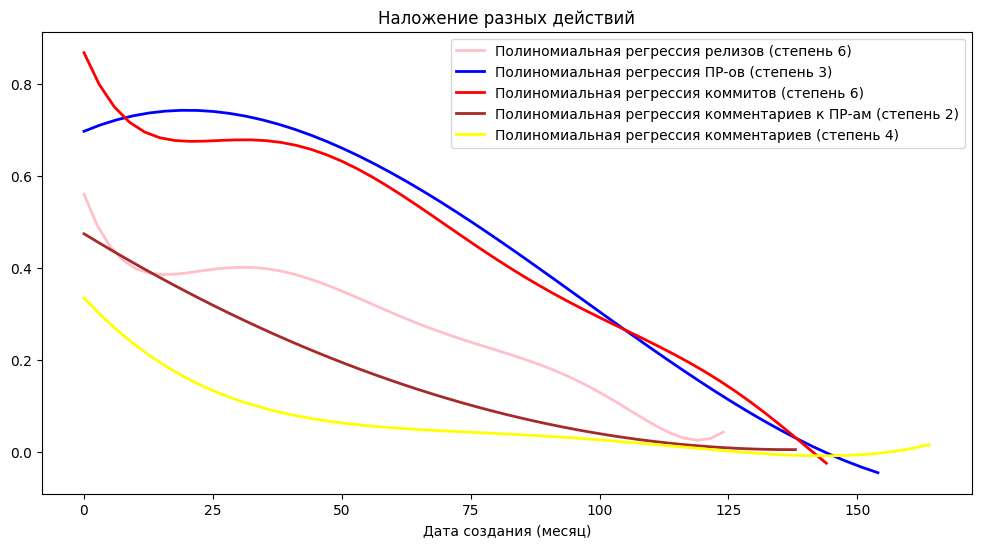

In [198]:
scaler = MinMaxScaler()
plt.figure(figsize=(12, 6))

df_prepared_rel = df_releases.groupby('t')['release_count'].sum().reset_index()
df_prepared_rel["release_count"] = scaler.fit_transform(df_prepared_rel[['release_count']])
poly_build(df_prepared_rel, 6, 'release_count', 'pink', 'релизов')

df_prepared_pull_request = df_pr.groupby('t')['pull_request_count'].sum().reset_index()
df_prepared_pull_request["pull_request_count"] = scaler.fit_transform(df_prepared_pull_request[['pull_request_count']])
poly_build(df_prepared_pull_request, 3, 'pull_request_count', 'blue', 'ПР-ов')

df_prepared_co = df_commits.groupby('t')['commit_count'].sum().reset_index()
df_prepared_co["commit_count"] = scaler.fit_transform(df_prepared_co[['commit_count']])
poly_build(df_prepared_co, 6, 'commit_count', 'red', 'коммитов')

df_prepared_pr_comment = df_pr_comment.groupby('t')['pull_request_comment_count'].sum().reset_index()
df_prepared_pr_comment["pull_request_comment_count"] = scaler.fit_transform(df_prepared_pr_comment[['pull_request_comment_count']])
poly_build(df_prepared_pr_comment, 2, 'pull_request_comment_count', 'brown', 'комментариев к ПР-ам')

df_prepared_pr_comment = df_comments.groupby('t')['comment_count'].sum().reset_index()
df_prepared_pr_comment["comment_count"] = scaler.fit_transform(df_prepared_pr_comment[['comment_count']])
poly_build(df_prepared_pr_comment, 4, 'comment_count', 'yellow', 'комментариев')

plt.xlabel("Дата создания (месяц)")
plt.title("Наложение разных действий")
plt.legend()